In [ ]:
!pip uninstall pandas-profiling
!pip install pandas-profiling

Uninstalling pandas-profiling-1.4.1:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/pandas_profiling-1.4.1.dist-info/*
    /usr/local/lib/python3.7/dist-packages/pandas_profiling/*
Proceed (y/n)? y
  Successfully uninstalled pandas-profiling-1.4.1
     |████████████████████████████████| 256kB 5.3MB/s 
     |████████████████████████████████| 3.1MB 8.8MB/s 
     |████████████████████████████████| 1.1MB 36.4MB/s 
     |████████████████████████████████| 10.1MB 38.5MB/s 
     |████████████████████████████████| 645kB 36.9MB/s 
     |████████████████████████████████| 112kB 46.7MB/s 
     |████████████████████████████████| 81kB 9.1MB/s 
     |████████████████████████████████| 61kB 8.0MB/s 
     |████████████████████████████████| 296kB 41.1MB/s 
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp37-none-any.whl size=27099 sha256=23d87ccb4d76d43aa7648b856978c4ae39846b77ba9bbe3627b6b0085ba61475
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db07

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
 
import pandas_profiling

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN

In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
data = pd.read_csv('/content/drive/MyDrive/oec.csv')

# I. Обработка данных

In [ ]:
mdata = data
mdata["PlanetaryMassJpt"][141]  -= 90
mdata["PlanetaryMassJpt"][2905]  -= 150
data = mdata

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
mdata = data
mdata[mdata.RadiusJpt > 2]
mdata["RadiusJpt"][1680]  -= 3
data = mdata

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
data['PeriodDays'].where(data['PeriodDays'] < 300000, 50000, inplace=True)
data.loc[data.PeriodDays > 300000, 'PeriodDays'] = data.loc[data.PeriodDays > 300000, 'PeriodDays'] - 25000
data.loc[data.PeriodDays > 50000, 'PeriodDays'] = data.loc[data.PeriodDays > 50000, 'PeriodDays'] - 50000
data.loc[data.PeriodDays > 140000, 'PeriodDays'] = 40000
data.loc[data.PeriodDays > 100000, 'PeriodDays'] = 30000

In [ ]:
data.loc[data.SemiMajorAxisAU > 50, 'SemiMajorAxisAU'] = data.loc[data.SemiMajorAxisAU > 50, 'SemiMajorAxisAU'] / 50
data.loc[data.SemiMajorAxisAU > 20, 'SemiMajorAxisAU'] = data.loc[data.SemiMajorAxisAU > 20, 'SemiMajorAxisAU'] / 20
data.loc[data.SemiMajorAxisAU > 5, 'SemiMajorAxisAU'] = data.loc[data.SemiMajorAxisAU > 5, 'SemiMajorAxisAU'] / 10

In [ ]:
data.loc[data.Eccentricity > 0.4, 'Eccentricity'] = data.loc[data.Eccentricity > 0.4, 'Eccentricity'] - 0.5

In [ ]:
data.loc[data.PeriastronDeg < 200, 'PeriastronDeg'] = data.loc[data.PeriastronDeg < 200, 'PeriastronDeg'] + 100
data.loc[data.PeriastronDeg > 700, 'PeriastronDeg'] = data.loc[data.PeriastronDeg > 700, 'PeriastronDeg'] - 500

In [ ]:
data.loc[data.InclinationDeg < 70, 'InclinationDeg'] = data.loc[data.InclinationDeg < 70, 'InclinationDeg'] + 30
data.loc[data.InclinationDeg < 70, 'InclinationDeg'] = data.loc[data.InclinationDeg < 70, 'InclinationDeg'] + 30
data.loc[data.InclinationDeg < 70, 'InclinationDeg'] = data.loc[data.InclinationDeg < 70, 'InclinationDeg'] + 30
data.loc[data.InclinationDeg > 300, 'InclinationDeg'] = data.loc[data.InclinationDeg > 300, 'InclinationDeg'] - 160

In [ ]:
data.loc[data.SurfaceTempK > 5000, 'SurfaceTempK'] = data.loc[data.SurfaceTempK > 5000, 'SurfaceTempK'] - 4000

In [ ]:
data.loc[data.HostStarTempK > 15000, 'HostStarTempK'] = data.loc[data.HostStarTempK > 15000, 'HostStarTempK'] - 17000

In [ ]:
data.loc[data.HostStarAgeGyr > 50, 'HostStarAgeGyr'] = data.loc[data.HostStarAgeGyr > 50, 'HostStarAgeGyr'] - 75

In [ ]:
data.loc[data.DistFromSunParsec > 2000, 'DistFromSunParsec'] = data.loc[data.DistFromSunParsec > 2000, 'DistFromSunParsec'] - 2000
data.loc[data.DistFromSunParsec > 4000, 'DistFromSunParsec'] = data.loc[data.DistFromSunParsec > 4000, 'DistFromSunParsec'] - 3000
data.loc[data.DistFromSunParsec > 2000, 'DistFromSunParsec'] = data.loc[data.DistFromSunParsec > 2000, 'DistFromSunParsec'] - 2000
data.loc[data.DistFromSunParsec > 1500, 'DistFromSunParsec'] = data.loc[data.DistFromSunParsec > 1500, 'DistFromSunParsec'] - 1500

In [ ]:
data.set_index('PlanetIdentifier', inplace=True)

In [ ]:
data.TypeFlag = np.where(data.TypeFlag == 0, 1, 0)
data.DiscoveryMethod = np.where(data.DiscoveryMethod == "transit", 1, 0)

def conditions(x):
  lst = [
         "Confirmed planets",
         "Confirmed planets, Planets in binary systems, S-type",
         "Confirmed planets, Planets in binary systems, P-type",
         "Confirmed planets, Planets in open clusters",
         "Solar System", "Kepler Objects of Interest",
         "Confirmed planets, Orphan planets",
         "Planets in binary systems, S-type, Confirmed planets",
         "Confirmed planets, Planets in binary systems, P-type, Planets in globular clusters"
  ]
  if x in lst:
      return 1
  else:
      return 0

func = np.vectorize(conditions)
data['ListsPlanetIsOn'] = func(data['ListsPlanetIsOn'])

In [ ]:
data = data.drop('DiscoveryYear', 1)
data = data.drop('LastUpdated', 1)

In [ ]:
origdata = data

# II. Кластеризация со столбцами долготы

In [ ]:
dolgdata = origdata
dolgdata = dolgdata.drop(columns=dolgdata.loc[:, dolgdata.count() < 3584/2].columns)

In [ ]:
dolgdata["Dec1"] = np.NaN
dolgdata["Dec2"] = np.NaN
dolgdata["Dec3"] = np.NaN

for i in range(dolgdata.shape[0]):
    x = dolgdata['Declination'].iloc[i]
    if x != x:
        dolgdata.loc[dolgdata.index[i], 'Dec1'] = np.NaN
        dolgdata.loc[dolgdata.index[i], 'Dec2'] = np.NaN
        dolgdata.loc[dolgdata.index[i], 'Dec3'] = np.NaN
    else:
        x = x.split(' ')
        dolgdata.loc[dolgdata.index[i], 'Dec1'] = float(x[0])
        dolgdata.loc[dolgdata.index[i], 'Dec2'] = float(x[1])
        dolgdata.loc[dolgdata.index[i], 'Dec3'] = float(x[2])

In [ ]:
dolgdata = dolgdata.drop('Declination', 1)
dolgdata['Dec1'].fillna(value=np.mean(dolgdata['Dec1']),inplace=True)
dolgdata['Dec2'].fillna(value=np.mean(dolgdata['Dec2']),inplace=True)
dolgdata['Dec3'].fillna(value=np.mean(dolgdata['Dec3']),inplace=True)

In [ ]:
dolgdata["Ra1"] = np.NaN
dolgdata["Ra2"] = np.NaN
dolgdata["Ra3"] = np.NaN

for i in range(dolgdata.shape[0]):
    x = dolgdata['RightAscension'].iloc[i]
    if x != x:
        dolgdata.loc[dolgdata.index[i], 'Ra1'] = np.NaN
        dolgdata.loc[dolgdata.index[i], 'Ra2'] = np.NaN
        dolgdata.loc[dolgdata.index[i], 'Ra3'] = np.NaN
    else:
        x = x.split(' ')
        dolgdata.loc[dolgdata.index[i], 'Ra1'] = float(x[0])
        dolgdata.loc[dolgdata.index[i], 'Ra2'] = float(x[1])
        dolgdata.loc[dolgdata.index[i], 'Ra3'] = float(x[2])

In [ ]:
dolgdata = dolgdata.drop('RightAscension', 1)
dolgdata['Ra1'].fillna(value=np.mean(dolgdata['Ra1']),inplace=True)
dolgdata['Ra2'].fillna(value=np.mean(dolgdata['Ra2']),inplace=True)
dolgdata['Ra3'].fillna(value=np.mean(dolgdata['Ra3']),inplace=True)

In [ ]:
dolgdata['PeriodDays'].fillna(np.mean(dolgdata['PeriodDays']), inplace=True)
dolgdata['DistFromSunParsec'].fillna(np.mean(dolgdata['DistFromSunParsec']), inplace=True)
dolgdata['HostStarMassSlrMass'].fillna(np.mean(dolgdata['HostStarMassSlrMass']), inplace=True)
dolgdata['HostStarRadiusSlrRad'].fillna(np.mean(dolgdata['HostStarRadiusSlrRad']), inplace=True)
dolgdata['HostStarMetallicity'].fillna(np.mean(dolgdata['HostStarMetallicity']), inplace=True)
dolgdata['HostStarTempK'].fillna(np.mean(dolgdata['HostStarTempK']), inplace=True)
dolgdata['RadiusJpt'].fillna(np.mean(dolgdata['RadiusJpt']), inplace=True)

In [ ]:
dolgdata.RadiusJpt = (dolgdata.RadiusJpt - dolgdata.RadiusJpt.mean()) / dolgdata.RadiusJpt.std()

In [ ]:
dolgdata.PeriodDays = (dolgdata.PeriodDays - dolgdata.PeriodDays.mean()) / dolgdata.PeriodDays.std()
dolgdata.DistFromSunParsec = (dolgdata.DistFromSunParsec - dolgdata.DistFromSunParsec.mean()) / dolgdata.DistFromSunParsec.std()
dolgdata.HostStarRadiusSlrRad = (dolgdata.HostStarRadiusSlrRad - dolgdata.HostStarRadiusSlrRad.mean()) / dolgdata.HostStarRadiusSlrRad.std()
dolgdata.HostStarTempK = (dolgdata.HostStarTempK - dolgdata.HostStarTempK.mean()) / dolgdata.HostStarTempK.std()

dolgdata.Ra1 = (dolgdata.Ra1 - dolgdata.Ra1.mean()) / dolgdata.Ra1.std()
dolgdata.Ra2 = (dolgdata.Ra2 - dolgdata.Ra1.mean()) / dolgdata.Ra2.std()
dolgdata.Ra3 = (dolgdata.Ra3 - dolgdata.Ra1.mean()) / dolgdata.Ra3.std()

dolgdata.Dec1 = (dolgdata.Dec1 - dolgdata.Dec1.mean()) / dolgdata.Dec1.std()
dolgdata.Dec2 = (dolgdata.Dec2 - dolgdata.Dec2.mean()) / dolgdata.Dec2.std()
dolgdata.Dec3 = (dolgdata.Dec3 - dolgdata.Dec3.mean()) / dolgdata.Dec3.std()

In [ ]:
dolgdata.Ra1 = (dolgdata.Ra1 - dolgdata.Ra1.mean()) / dolgdata.Ra1.std()
dolgdata.Ra2 = (dolgdata.Ra2 - dolgdata.Ra1.mean()) / dolgdata.Ra2.std()
dolgdata.Ra3 = (dolgdata.Ra3 - dolgdata.Ra1.mean()) / dolgdata.Ra3.std()

dolgdata.Dec1 = (dolgdata.Dec1 - dolgdata.Dec1.mean()) / dolgdata.Dec1.std()
dolgdata.Dec2 = (dolgdata.Dec2 - dolgdata.Dec2.mean()) / dolgdata.Dec2.std()
dolgdata.Dec3 = (dolgdata.Dec3 - dolgdata.Dec3.mean()) / dolgdata.Dec3.std()

In [ ]:
pandas_profiling.ProfileReport(dolgdata)

Summarize dataset:   0%|          | 0/30 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Снижение размерности

In [ ]:
pca = PCA()
pca.fit(dolgdata)
X_pca = pca.transform(dolgdata)

In [ ]:
for i, component in enumerate(pca.components_):
    print("{} component: {}% of initial variance".format(i + 1, 
          round(100 * pca.explained_variance_ratio_[i], 2)))
    print(" + ".join("%.3f x %s" % (value, name)
                     for value, name in zip(component, dolgdata.columns)))

1 component: 19.3% of initial variance
-0.031 x TypeFlag + 0.321 x RadiusJpt + 0.213 x PeriodDays + -0.206 x DiscoveryMethod + -0.436 x DistFromSunParsec + 0.021 x HostStarMassSlrMass + 0.182 x HostStarRadiusSlrRad + 0.001 x HostStarMetallicity + -0.107 x HostStarTempK + -0.020 x ListsPlanetIsOn + -0.547 x Dec1 + -0.034 x Dec2 + -0.050 x Dec3 + -0.518 x Ra1 + 0.003 x Ra2 + -0.036 x Ra3
2 component: 11.27% of initial variance
-0.001 x TypeFlag + 0.530 x RadiusJpt + 0.159 x PeriodDays + 0.059 x DiscoveryMethod + 0.333 x DistFromSunParsec + 0.099 x HostStarMassSlrMass + -0.231 x HostStarRadiusSlrRad + 0.020 x HostStarMetallicity + 0.694 x HostStarTempK + 0.006 x ListsPlanetIsOn + -0.113 x Dec1 + -0.114 x Dec2 + 0.065 x Dec3 + -0.008 x Ra1 + 0.057 x Ra2 + -0.035 x Ra3
3 component: 9.52% of initial variance
0.007 x TypeFlag + 0.115 x RadiusJpt + -0.445 x PeriodDays + 0.022 x DiscoveryMethod + 0.037 x DistFromSunParsec + 0.104 x HostStarMassSlrMass + 0.445 x HostStarRadiusSlrRad + -0.003 x H

Text(0, 0.5, 'Описание дисперсии')

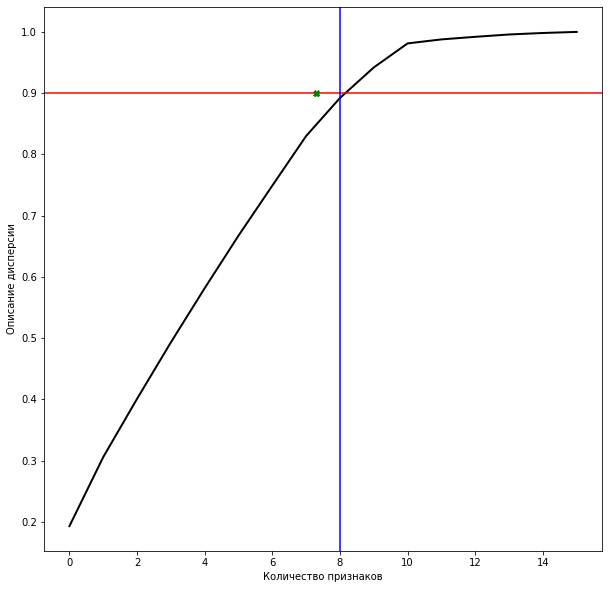

In [ ]:
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), color='k', lw=2)
plt.axhline(0.9, c='r')
plt.axvline(8, c='b')

plt.plot(7.3, 0.9, 'gX')

plt.xlabel('Количество признаков')
plt.ylabel('Описание дисперсии')

# III. Кластеризация без столбцов долготы

In [ ]:
data2 = origdata

In [ ]:
data2.PeriodDays = (data2.PeriodDays - data2.PeriodDays.mean()) / data2.PeriodDays.std()
data2.DistFromSunParsec = (data2.DistFromSunParsec - data2.DistFromSunParsec.mean()) / data2.DistFromSunParsec.std()
data2.HostStarRadiusSlrRad = (data2.HostStarRadiusSlrRad - data2.HostStarRadiusSlrRad.mean()) / data2.HostStarRadiusSlrRad.std()
data2.HostStarTempK = (data2.HostStarTempK - data2.HostStarTempK.mean()) / data2.HostStarTempK.std()

In [ ]:
data2 = data2.drop(columns=data2.loc[:, data2.count() < 3584/2].columns)

In [ ]:
data2['RadiusJpt'].fillna(np.mean(data2['RadiusJpt']), inplace=True)
data2['PeriodDays'].fillna(np.mean(data2['PeriodDays']), inplace=True)
data2['DistFromSunParsec'].fillna(np.mean(data2['DistFromSunParsec']), inplace=True)
data2['HostStarMassSlrMass'].fillna(np.mean(data2['HostStarMassSlrMass']), inplace=True)
data2['HostStarRadiusSlrRad'].fillna(np.mean(data2['HostStarRadiusSlrRad']), inplace=True)
data2['HostStarMetallicity'].fillna(np.mean(data2['HostStarMetallicity']), inplace=True)
data2['HostStarTempK'].fillna(np.mean(data2['HostStarTempK']), inplace=True)

In [ ]:
data2 = data2.drop("RightAscension", 1)

In [ ]:
data2 = data2.drop("Declination", 1)

In [ ]:
pca = PCA()
pca.fit(data2)
X_pca = pca.transform(data2)

In [ ]:
for i, component in enumerate(pca.components_):
    print("{} component: {}% of initial variance".format(i + 1, 
          round(100 * pca.explained_variance_ratio_[i], 2)))
    print(" + ".join("%.3f x %s" % (value, name)
                     for value, name in zip(component, data2.columns)))

1 component: 28.6% of initial variance
-0.028 x TypeFlag + -0.015 x RadiusJpt + 0.354 x PeriodDays + -0.204 x DiscoveryMethod + -0.358 x DistFromSunParsec + -0.064 x HostStarMassSlrMass + 0.472 x HostStarRadiusSlrRad + -0.018 x HostStarMetallicity + -0.690 x HostStarTempK + -0.020 x ListsPlanetIsOn
2 component: 25.47% of initial variance
-0.024 x TypeFlag + 0.056 x RadiusJpt + 0.908 x PeriodDays + -0.101 x DiscoveryMethod + 0.037 x DistFromSunParsec + 0.016 x HostStarMassSlrMass + -0.160 x HostStarRadiusSlrRad + 0.009 x HostStarMetallicity + 0.366 x HostStarTempK + -0.018 x ListsPlanetIsOn
3 component: 22.59% of initial variance
-0.008 x TypeFlag + 0.061 x RadiusJpt + -0.082 x PeriodDays + -0.083 x DiscoveryMethod + 0.002 x DistFromSunParsec + 0.230 x HostStarMassSlrMass + 0.814 x HostStarRadiusSlrRad + -0.005 x HostStarMetallicity + 0.516 x HostStarTempK + -0.000 x ListsPlanetIsOn
4 component: 14.13% of initial variance
0.045 x TypeFlag + -0.070 x RadiusJpt + 0.151 x PeriodDays + 0.22

In [ ]:
X_pca[:, :3].shape

(3584, 3)

Text(0, 0.5, 'Описание дисперсии')

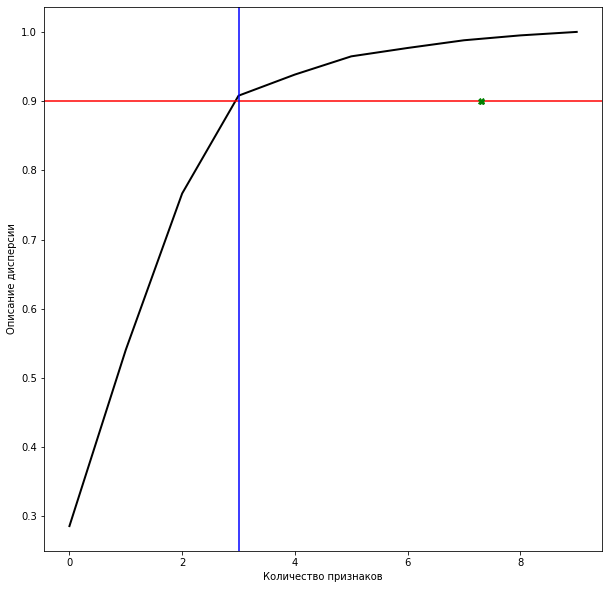

In [ ]:
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), color='k', lw=2)
plt.axhline(0.9, c='r')
plt.axvline(3, c='b')

plt.plot(7.3, 0.9, 'gX')

plt.xlabel('Количество признаков')
plt.ylabel('Описание дисперсии')

Вместо pyplot используем plotly 

In [ ]:
import plotly.express as px
import plotly.graph_objects as go

In [ ]:
fig = px.scatter_3d(X_pca[:, :3], x=0, y=1, z=2, size_max=18, opacity=0.7)
fig.show()

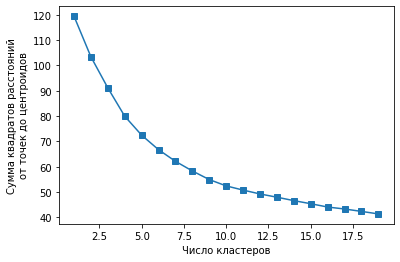

In [ ]:
from sklearn.cluster import KMeans

inertia = []
for k in range(1, 20):
    kmeans_iter = KMeans(n_clusters=k, random_state=42).fit(data2)
    inertia.append(np.sqrt(kmeans_iter.inertia_))

plt.plot(range(1, 20), inertia, marker='s');
plt.xlabel("Число кластеров")
plt.ylabel("Cумма квадратов расстояний\nот точек до центроидов");

In [ ]:
kmeans = KMeans(n_clusters=10, random_state=42)

# Проводим моделирование
kmeans.fit(data2)
all_predictions = kmeans.predict(data2)

In [ ]:
fig = px.scatter_3d(X_pca[:, :3], x=0, y=1, z=2, size_max=18, opacity=0.7, color=all_predictions)
fig.show()

In [ ]:
fig = px.scatter_3d(solar, x='0', y='1', z='2', size_max=18, opacity=0.7, color = "class", text= "name")
fig.show()

(9, 3)

In [ ]:
result = X_pca
solar_indexes = [data2.index.get_loc("Earth"), data2.index.get_loc("Mercury"), data2.index.get_loc("Venus"),
                 data2.index.get_loc("Mars"), data2.index.get_loc("Jupiter"), data2.index.get_loc("Saturn"),
                 data2.index.get_loc("Uranus"), data2.index.get_loc("Neptune"), data2.index.get_loc("Pluto")]
solar_name = ["Earth", "Mercury", "Venus", "Mars", "Jupiter", "Saturn", "Uranus", "Neptune", "Pluto"]


earth = result[data2.index.get_loc("Earth")]
mercury = result[data2.index.get_loc("Mercury")]
    
venus = result[data2.index.get_loc("Venus")]
    
mars = result[data2.index.get_loc("Mars")]
jupiter = result[data2.index.get_loc("Jupiter")]
    
saturn = result[data2.index.get_loc("Saturn")]
    
uranus = result[data2.index.get_loc("Uranus")]
    
neptune = result[data2.index.get_loc("Neptune")]
    
pluto = result[data2.index.get_loc("Pluto")]

solar = np.array([earth, mercury, venus, mars, jupiter, saturn, uranus, neptune, pluto])

solar = pd.DataFrame({'0': solar[:, 0], '1': solar[:, 1], '2':solar[:, 2]})

solar["index"] = np.NaN
solar["class"] = np.NaN
solar["name"] = np.NaN

for i in range(solar.shape[0]):
    solar["index"].iloc[i] = solar_indexes[i] 
    solar['class'].iloc[i] = all_predictions[i]
    solar["name"].iloc[i] = solar_name[i]

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:670: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
solar

,0,1,2,index,class,name
0,-0.239479,0.079992,0.127326,410.0,7.0,Earth
1,-0.250299,0.046894,0.126626,408.0,7.0,Mercury
2,-0.245330,0.064557,0.128427,409.0,2.0,Venus
3,-0.225269,0.112354,0.121580,411.0,2.0,Mars
4,-0.086250,0.559448,0.143688,412.0,2.0,Jupiter
5,0.186923,1.243812,0.070575,413.0,8.0,Saturn
6,1.033898,3.370246,-0.153380,414.0,8.0,Uranus
7,0.170462,1.155784,0.046895,415.0,8.0,Neptune
8,1.454884,4.416443,-0.271141,416.0,2.0,Pluto


# IV. Кластеризация с использованием столбцов массы

Отдельно стоит рассмотреть кластеризацию, вернув столбцы у которых потеря данных составляет более 50%. Избавимся от строк с недостоющими данными

In [215]:
massdata = origdata

In [216]:
massdata = massdata[massdata['PlanetaryMassJpt'].notna()]

In [217]:
massdata

,TypeFlag,PlanetaryMassJpt,RadiusJpt,PeriodDays,SemiMajorAxisAU,Eccentricity,PeriastronDeg,LongitudeDeg,AscendingNodeDeg,InclinationDeg,SurfaceTempK,AgeGyr,DiscoveryMethod,RightAscension,Declination,DistFromSunParsec,HostStarMassSlrMass,HostStarRadiusSlrRad,HostStarMetallicity,HostStarTempK,HostStarAgeGyr,ListsPlanetIsOn
PlanetIdentifier,,,,,,,,,,,,,,,,,,,,,,
HD 143761 b,1,1.0450,NaN,-0.197887,0.2196,0.0370,270.60,NaN,NaN,NaN,NaN,NaN,0,16 01 03,+33 18 13,-1.003684,0.889,-0.043509,-0.31,0.190231,NaN,1
HD 143761 c,1,0.0790,NaN,-0.190429,0.4123,0.0500,290.00,NaN,NaN,NaN,NaN,NaN,0,16 01 03,+33 18 13,-1.003684,0.889,-0.043509,-0.31,0.190231,NaN,1
KOI-1843.03,1,0.0014,0.054,-0.202606,0.0048,NaN,NaN,NaN,NaN,72.0,NaN,NaN,1,19 00 03.14,+40 13 14.7,NaN,0.460,-0.340452,0.00,-2.383419,NaN,0
Kepler-9 b,1,0.2500,0.840,-0.200340,0.1430,0.0626,NaN,NaN,NaN,87.1,707.2,NaN,1,19 02 17,+38 24 03,0.589350,1.070,-0.154863,0.12,0.379192,NaN,1
Kepler-9 c,1,0.1700,0.820,-0.197984,0.2290,0.0684,NaN,NaN,NaN,87.2,557.9,NaN,1,19 02 17,+38 24 03,0.589350,1.070,-0.154863,0.12,0.379192,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HAT-P-34 b,1,3.3280,1.197,-0.201978,0.0677,-0.0590,NaN,NaN,NaN,87.1,1335.3,NaN,1,20 12 46.885,+18 06 17.42,-0.400059,1.392,0.012819,0.22,1.216919,NaN,1
eta Cet b,1,2.4600,NaN,-0.154176,1.2700,0.1700,247.20,NaN,NaN,81.9,NaN,NaN,0,01 08 35.39148,-10 10 56.1570,-0.951434,1.700,4.169043,0.12,-1.194224,NaN,1
eta Cet c,1,3.1600,NaN,-0.114088,1.9300,0.0200,136.67,NaN,NaN,81.9,NaN,NaN,0,01 08 35.39148,-10 10 56.1570,-0.951434,1.700,4.169043,0.12,-1.194224,NaN,1


In [218]:
massdata = massdata.drop(massdata.loc[:, massdata.count() < 1313/2].columns, 1)

In [219]:
massdata

,TypeFlag,PlanetaryMassJpt,PeriodDays,SemiMajorAxisAU,Eccentricity,SurfaceTempK,DiscoveryMethod,RightAscension,Declination,DistFromSunParsec,HostStarMassSlrMass,HostStarRadiusSlrRad,HostStarMetallicity,HostStarTempK,ListsPlanetIsOn
PlanetIdentifier,,,,,,,,,,,,,,,
HD 143761 b,1,1.0450,-0.197887,0.2196,0.0370,NaN,0,16 01 03,+33 18 13,-1.003684,0.889,-0.043509,-0.31,0.190231,1
HD 143761 c,1,0.0790,-0.190429,0.4123,0.0500,NaN,0,16 01 03,+33 18 13,-1.003684,0.889,-0.043509,-0.31,0.190231,1
KOI-1843.03,1,0.0014,-0.202606,0.0048,NaN,NaN,1,19 00 03.14,+40 13 14.7,NaN,0.460,-0.340452,0.00,-2.383419,0
Kepler-9 b,1,0.2500,-0.200340,0.1430,0.0626,707.2,1,19 02 17,+38 24 03,0.589350,1.070,-0.154863,0.12,0.379192,1
Kepler-9 c,1,0.1700,-0.197984,0.2290,0.0684,557.9,1,19 02 17,+38 24 03,0.589350,1.070,-0.154863,0.12,0.379192,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
HAT-P-34 b,1,3.3280,-0.201978,0.0677,-0.0590,1335.3,1,20 12 46.885,+18 06 17.42,-0.400059,1.392,0.012819,0.22,1.216919,1
eta Cet b,1,2.4600,-0.154176,1.2700,0.1700,NaN,0,01 08 35.39148,-10 10 56.1570,-0.951434,1.700,4.169043,0.12,-1.194224,1
eta Cet c,1,3.1600,-0.114088,1.9300,0.0200,NaN,0,01 08 35.39148,-10 10 56.1570,-0.951434,1.700,4.169043,0.12,-1.194224,1


In [220]:
massdata["Dec1"] = np.NaN
massdata["Dec2"] = np.NaN
massdata["Dec3"] = np.NaN

for i in range(massdata.shape[0]):
    x = massdata['Declination'].iloc[i]
    if x != x:
        massdata.loc[massdata.index[i], 'Dec1'] = np.NaN
        massdata.loc[massdata.index[i], 'Dec2'] = np.NaN
        massdata.loc[massdata.index[i], 'Dec3'] = np.NaN
    else:
        x = x.split(' ')
        massdata.loc[massdata.index[i], 'Dec1'] = float(x[0])
        massdata.loc[massdata.index[i], 'Dec2'] = float(x[1])
        massdata.loc[massdata.index[i], 'Dec3'] = float(x[2])

In [221]:
massdata = massdata.drop('Declination', 1)
massdata['Dec1'].fillna(value=np.mean(massdata['Dec1']),inplace=True)
massdata['Dec2'].fillna(value=np.mean(massdata['Dec2']),inplace=True)
massdata['Dec3'].fillna(value=np.mean(massdata['Dec3']),inplace=True)

In [222]:
massdata["Ra1"] = np.NaN
massdata["Ra2"] = np.NaN
massdata["Ra3"] = np.NaN

for i in range(massdata.shape[0]):
    x = massdata['RightAscension'].iloc[i]
    if x != x:
        massdata.loc[massdata.index[i], 'Ra1'] = np.NaN
        massdata.loc[massdata.index[i], 'Ra2'] = np.NaN
        massdata.loc[massdata.index[i], 'Ra3'] = np.NaN
    else:
        x = x.split(' ')
        massdata.loc[massdata.index[i], 'Ra1'] = float(x[0])
        massdata.loc[massdata.index[i], 'Ra2'] = float(x[1])
        massdata.loc[massdata.index[i], 'Ra3'] = float(x[2])

In [223]:
massdata = massdata.drop('RightAscension', 1)
massdata['Ra1'].fillna(value=np.mean(massdata['Ra1']),inplace=True)
massdata['Ra2'].fillna(value=np.mean(massdata['Ra2']),inplace=True)
massdata['Ra3'].fillna(value=np.mean(massdata['Ra3']),inplace=True)

In [224]:
massdata['PeriodDays'].fillna(np.mean(massdata['PeriodDays']), inplace=True)
massdata['DistFromSunParsec'].fillna(np.mean(massdata['DistFromSunParsec']), inplace=True)
massdata['HostStarMassSlrMass'].fillna(np.mean(massdata['HostStarMassSlrMass']), inplace=True)
massdata['HostStarRadiusSlrRad'].fillna(np.mean(massdata['HostStarRadiusSlrRad']), inplace=True)
massdata['HostStarMetallicity'].fillna(np.mean(massdata['HostStarMetallicity']), inplace=True)
massdata['HostStarTempK'].fillna(np.mean(massdata['HostStarTempK']), inplace=True)
massdata['Eccentricity'].fillna(np.mean(massdata['Eccentricity']), inplace=True)
massdata['SurfaceTempK'].fillna(np.mean(massdata['SurfaceTempK']), inplace=True)
massdata['SemiMajorAxisAU'].fillna(np.mean(massdata['SemiMajorAxisAU']), inplace=True)

In [225]:
massdata.PeriodDays = (massdata.PeriodDays - massdata.PeriodDays.mean()) / massdata.PeriodDays.std()
massdata.DistFromSunParsec = (massdata.DistFromSunParsec - massdata.DistFromSunParsec.mean()) / massdata.DistFromSunParsec.std()
massdata.HostStarRadiusSlrRad = (massdata.HostStarRadiusSlrRad - massdata.HostStarRadiusSlrRad.mean()) / massdata.HostStarRadiusSlrRad.std()
massdata.HostStarTempK = (massdata.HostStarTempK - massdata.HostStarTempK.mean()) / massdata.HostStarTempK.std()
massdata.SurfaceTempK = (massdata.SurfaceTempK - massdata.SurfaceTempK.mean()) / massdata.SurfaceTempK.std()
massdata.HostStarMetallicity = (massdata.HostStarMetallicity - massdata.HostStarMetallicity.mean()) / massdata.HostStarMetallicity.std()
massdata.HostStarMassSlrMass = (massdata.HostStarMassSlrMass - massdata.HostStarMassSlrMass.mean()) / massdata.HostStarMassSlrMass.std()
massdata.PlanetaryMassJpt = (massdata.PlanetaryMassJpt - massdata.PlanetaryMassJpt.mean()) / massdata.PlanetaryMassJpt.std()
massdata.SemiMajorAxisAU = (massdata.SemiMajorAxisAU - massdata.SemiMajorAxisAU.mean()) / massdata.SemiMajorAxisAU.std()
massdata.Eccentricity = (massdata.Eccentricity - massdata.Eccentricity.mean()) / massdata.Eccentricity.std()

massdata.Ra1 = (massdata.Ra1 - massdata.Ra1.mean()) / massdata.Ra1.std()
massdata.Ra2 = (massdata.Ra2 - massdata.Ra1.mean()) / massdata.Ra2.std()
massdata.Ra3 = (massdata.Ra3 - massdata.Ra1.mean()) / massdata.Ra3.std()

massdata.Dec1 = (massdata.Dec1 - massdata.Dec1.mean()) / massdata.Dec1.std()
massdata.Dec2 = (massdata.Dec2 - massdata.Dec2.mean()) / massdata.Dec2.std()
massdata.Dec3 = (massdata.Dec3 - massdata.Dec3.mean()) / massdata.Dec3.std()

In [210]:
massdata.isna().any()

TypeFlag                False
PlanetaryMassJpt        False
PeriodDays              False
SemiMajorAxisAU         False
Eccentricity            False
SurfaceTempK            False
DiscoveryMethod         False
DistFromSunParsec       False
HostStarMassSlrMass     False
HostStarRadiusSlrRad    False
HostStarMetallicity     False
HostStarTempK           False
ListsPlanetIsOn         False
Dec1                    False
Dec2                    False
Dec3                    False
Ra1                     False
Ra2                     False
Ra3                     False
dtype: bool

In [232]:
massdata = massdata.drop("HostStarMassSlrMass", 1)

In [233]:
massdata = massdata.drop("DiscoveryMethod", 1)

In [ ]:
massdata = massdata.drop("ListsPlanetIsOn", 1)

In [ ]:
massdata = massdata.drop("TypeFlag", 1)

In [240]:
massdata = massdata.drop("HostStarMetallicity", 1)

In [159]:
 massdata = massdata.drop("SemiMajorAxisAU", 1)

In [227]:
massdata = massdata.drop("Ra2", 1)
massdata = massdata.drop("Ra3", 1)
massdata = massdata.drop("Dec2", 1)
massdata = massdata.drop("Dec3", 1)

In [136]:
ProfileReport(massdata)

Summarize dataset:   0%|          | 0/27 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [241]:
pca = PCA()
pca.fit(massdata)
X_pca = pca.transform(massdata)

In [242]:
for i, component in enumerate(pca.components_):
    print("{} component: {}% of initial variance".format(i + 1, 
          round(100 * pca.explained_variance_ratio_[i], 2)))
    print(" + ".join("%.3f x %s" % (value, name)
                     for value, name in zip(component, massdata.columns)))

1 component: 19.72% of initial variance
-0.138 x PlanetaryMassJpt + -0.017 x PeriodDays + -0.453 x SemiMajorAxisAU + -0.365 x Eccentricity + 0.475 x SurfaceTempK + 0.438 x DistFromSunParsec + -0.238 x HostStarRadiusSlrRad + 0.306 x HostStarTempK + 0.182 x Dec1 + 0.202 x Ra1
2 component: 14.1% of initial variance
0.556 x PlanetaryMassJpt + 0.564 x PeriodDays + 0.318 x SemiMajorAxisAU + 0.098 x Eccentricity + 0.158 x SurfaceTempK + 0.272 x DistFromSunParsec + 0.214 x HostStarRadiusSlrRad + 0.146 x HostStarTempK + 0.103 x Dec1 + 0.292 x Ra1
3 component: 12.11% of initial variance
-0.048 x PlanetaryMassJpt + -0.370 x PeriodDays + -0.006 x SemiMajorAxisAU + 0.054 x Eccentricity + -0.039 x SurfaceTempK + 0.102 x DistFromSunParsec + 0.501 x HostStarRadiusSlrRad + -0.247 x HostStarTempK + 0.694 x Dec1 + 0.230 x Ra1
4 component: 10.89% of initial variance
0.335 x PlanetaryMassJpt + -0.021 x PeriodDays + -0.232 x SemiMajorAxisAU + -0.175 x Eccentricity + 0.465 x SurfaceTempK + -0.193 x DistFromS

Text(0, 0.5, 'Описание дисперсии')

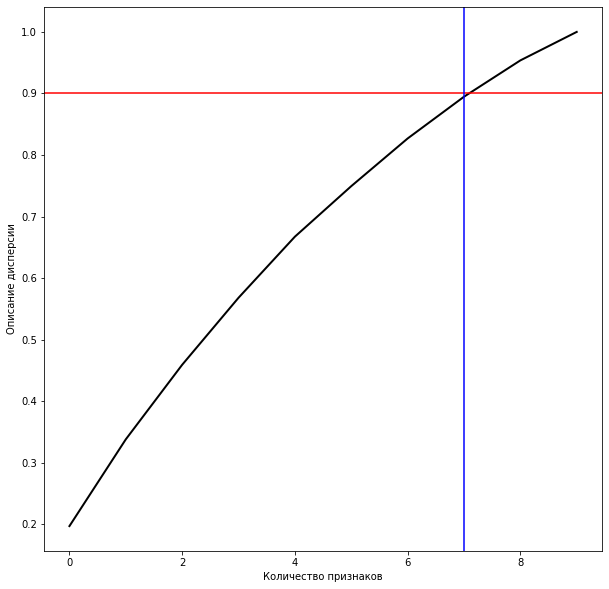

In [243]:
plt.figure(figsize=(10,10))
plt.plot(np.cumsum(pca.explained_variance_ratio_), color='k', lw=2)
plt.axhline(0.9, c='r')
plt.axvline(7, c='b')

plt.xlabel('Количество признаков')
plt.ylabel('Описание дисперсии')